<a href="https://colab.research.google.com/github/galvaowesley/resunet-explorer/blob/main/resunet_explorer_example.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Build environment

In [1]:
!rm -rf resunet-explorer
!git clone https://github.com/galvaowesley/resunet-explorer.git

Cloning into 'resunet-explorer'...
remote: Enumerating objects: 96, done.
remote: Counting objects: 100% (96/96), done.
remote: Compressing objects: 100% (79/79), done.
remote: Total 96 (delta 47), reused 39 (delta 13), pack-reused 0
Unpacking objects: 100% (96/96), done.


In [2]:
! cd resunet-explorer/ && git pull

Already up to date.


In [3]:
! rm -rf resunetexplorer

In [4]:
! cd resunet-explorer && mv resunetexplorer /content/resunetexplorer

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Unzip torchtrainer library
!unzip '/content/drive/MyDrive/Iniciação Científica/Wesley Galvão.lnk/Notebooks/Dados/torchtrainer.zip' -d '/content/'
# Copy model checkpoint 
!cp '/content/drive/MyDrive/Iniciação Científica/Wesley Galvão.lnk/Modelos/learner_vessel.tar' '/content/'
# Copy image dataset
!cp '/content/drive/MyDrive/Iniciação Científica/Wesley Galvão.lnk/Notebooks/Dados/data' -r '/content'

# Resunet Explorer

## Import libraries

In [ ]:
# Progress bar
! pip install pyprog
# Install imgaug
!pip install imgaug==0.4

In [9]:
from re import split

import pyprog

# Initial imports and device setting
from pathlib import Path
from functools import partial


import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import torch
import torch.nn as nn
from torch.nn.functional import interpolate 
from torch.functional import F
import imgaug.augmenters as iaa

# Libraries for graph
import networkx.drawing as draw
import networkx as nx

import math 
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px

from plotly.subplots import make_subplots
import plotly.graph_objects as go


from torchtrainer.imagedataset import ImageSegmentationDataset
from torchtrainer import img_util
from torchtrainer import transforms
from torchtrainer.models.resunet import ResUNet
#from torchtrainer.module_util import (ActivationSampler, split_modules, get_submodule, get_submodule_str, model_up_to, get_output_shape)

# Import Resunet Explorer library 
from resunetexplorer.layer_extractor import ExtractResUNetLayers
from resunetexplorer.maps_extractor import ExtractResUNetMaps
from resunetexplorer.utils import ActivationSampler

import scipy
from scipy import ndimage, misc

# PCA module
from sklearn.decomposition import PCA


use_cuda = True

if use_cuda and torch.cuda.is_available():
    device = torch.device('cuda')
    dev_info = torch.cuda.get_device_properties(device)
    print(dev_info)
else:
    device = torch.device('cpu')

_CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


## Functions

In [10]:
def dataset_creation(root_dir_, img_dir_, label_dir_):
  """
  Load the dataset given the complet path.
  """
  # Dataset creation
  def img_name_to_label(filename):
      return filename.split('.')[0] + '.png'

  root_dir = Path(root_dir_)
  img_dir = root_dir/img_dir_
  label_dir = root_dir/label_dir_

  # Data transformations
  imgaug_seq = iaa.Sequential([
      iaa.CLAHE(clip_limit=6, tile_grid_size_px=12)
  ])    
  imgaug_seq = transforms.translate_imagaug_seq(imgaug_seq)
  valid_transforms = [transforms.TransfToImgaug(), imgaug_seq, transforms.TransfToTensor(), 
                      transforms.TransfWhitten(67.576, 37.556)]

  img_opener = partial(img_util.pil_img_opener, channel=None)
  label_opener = partial(img_util.pil_img_opener, is_label=True)
  dataset = ImageSegmentationDataset(img_dir, label_dir, name_to_label_map=img_name_to_label, img_opener=img_opener, 
                                    label_opener=label_opener, transforms=valid_transforms)

  return dataset

In [11]:
def load_model_checkpoint(path, device):
  """
  Load the model from a checkpoint given a path to file and the device which 
  will process the model
  """
  checkpoint = torch.load(path, map_location=torch.device(device))
  model = ResUNet(num_channels=1, num_classes=2) 
  model.load_state_dict(checkpoint['model_state'])
  model.eval()
  model.to(device);

  return model

## Feature maps visulization example


In [12]:
# Load dataset
dataset = dataset_creation('data', 'CD31(vessels)', 'labels')
# Model path
model_path = 'learner_vessel.tar'
# Load model
model = load_model_checkpoint(model_path, device)

### Extract ResUNet Layers 

In [15]:
# ExtractResUNetLayers test
layers_paths = ['encoder.resblock2', 'a_mid_up']
erl = ExtractResUNetLayers(model, layers_paths)
layers = erl.get_layers()

In [16]:
layers

{'layer': [ResBlock(
    (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (reshape_input): Sequential(
      (0): Conv2d(64, 128, kernel_size=(1, 1), stride=(2, 2), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  ), ConvTranspose2d(1024, 512, kernel_size=(2, 2), stride=(2, 2))],
 'n_maps': [128, 512],
 'network_part': ['encoder.resblock2', 'a_mid_up']}

### FIXME: 
A obtenção do submodulo não está funcionando para camadas da parte 'decoder' da rede. 

In [19]:
layer_path = ['_l4']
erl = ExtractResUNetLayers(model, layer_path)
layers = erl.get_layers()

TypeError: ignored

### Extract ResUNet Maps

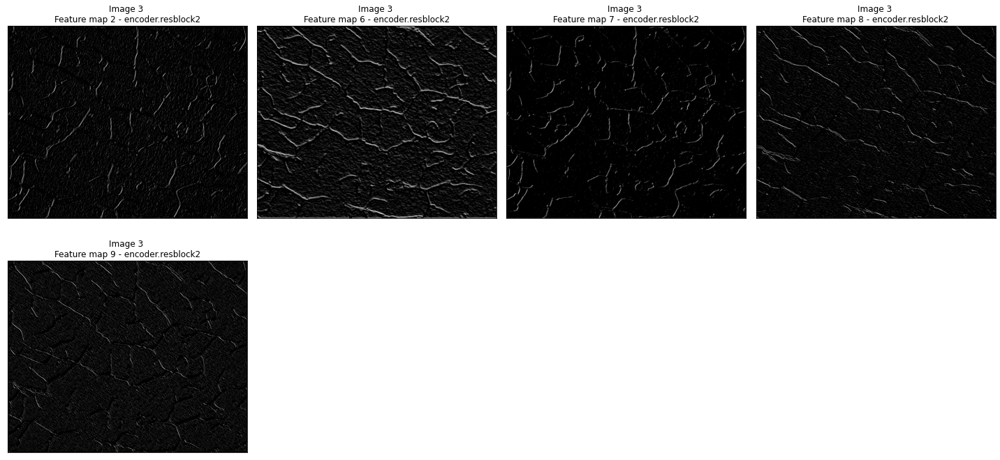

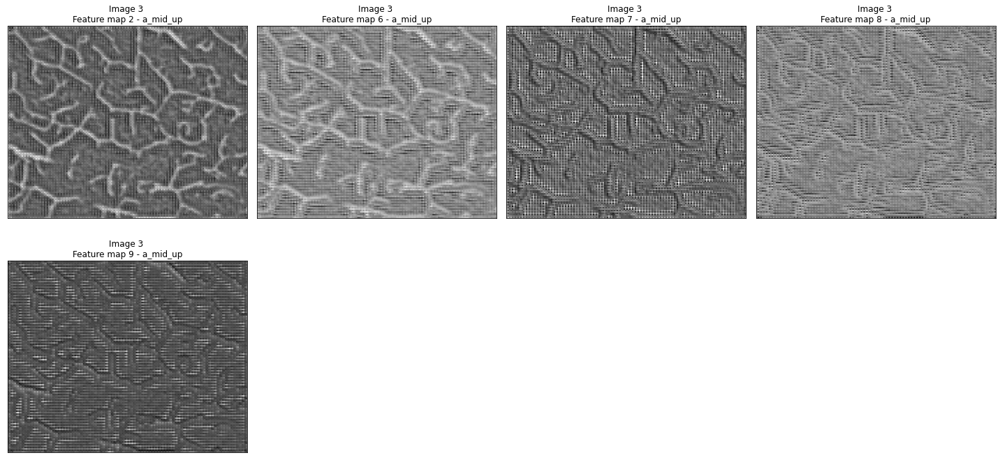

In [17]:
erm = ExtractResUNetMaps(model, dataset, device)
img_idx = 3

layers_fm_list = erm.get_multiple_feature_maps(img_idx, layers['layer'])

maps_idx = [2, 6 , 7, 8, 9]

erm.show_feature_maps(layers, layers_fm_list, img_idx, maps_idx)

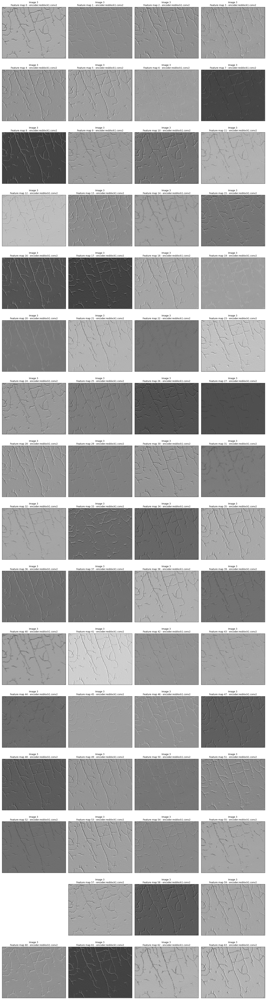

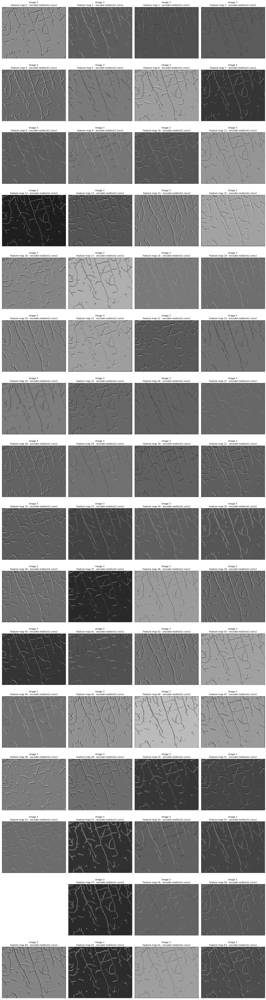

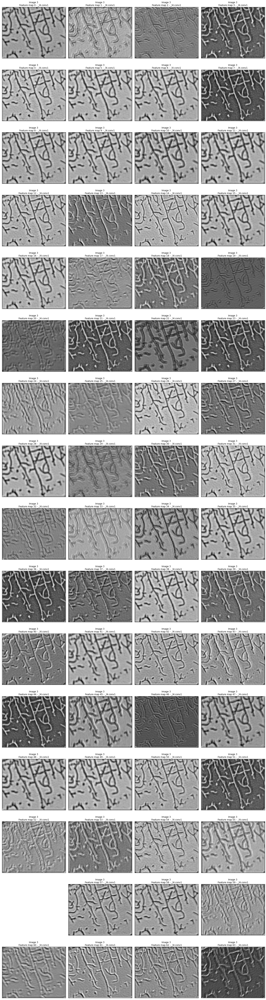

In [ ]:
erm.show_feature_maps(layers, layers_fm_list, img_idx)

### Extract ResUnet kernels

In [ ]:
erm = ExtractResUNetMaps(model, dataset, device)
kernels_list = erm.get_multiple_kernels(layers['layer'])

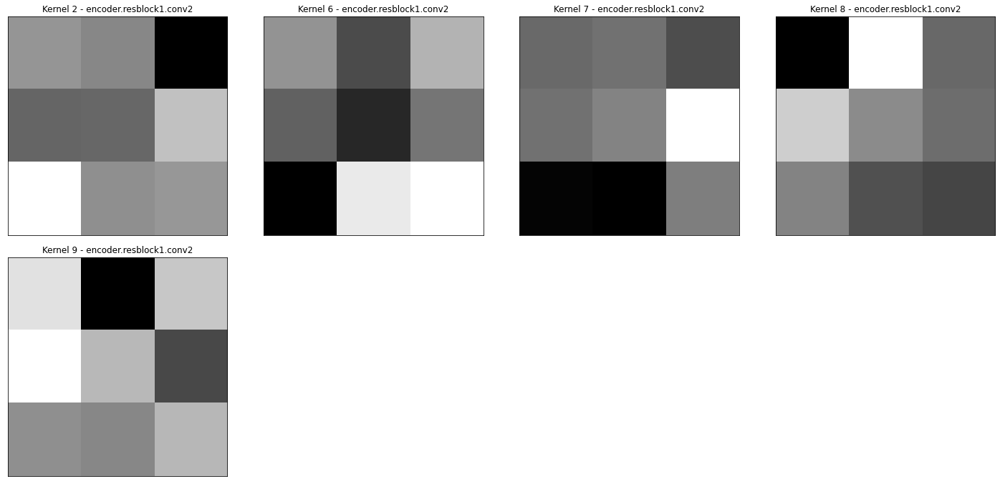

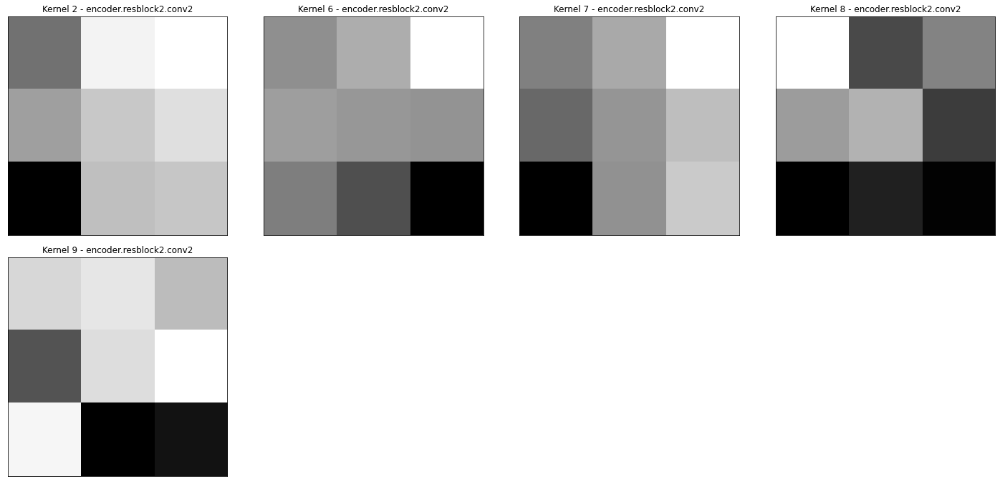

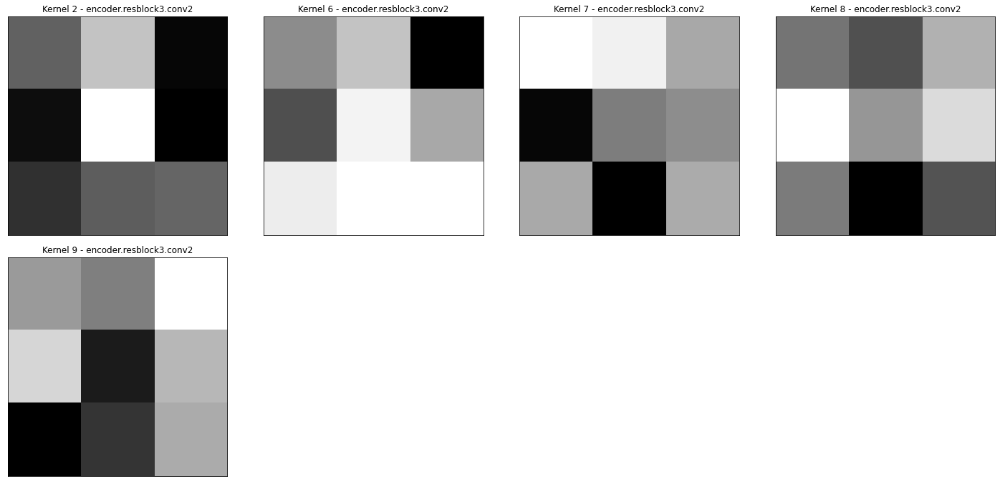

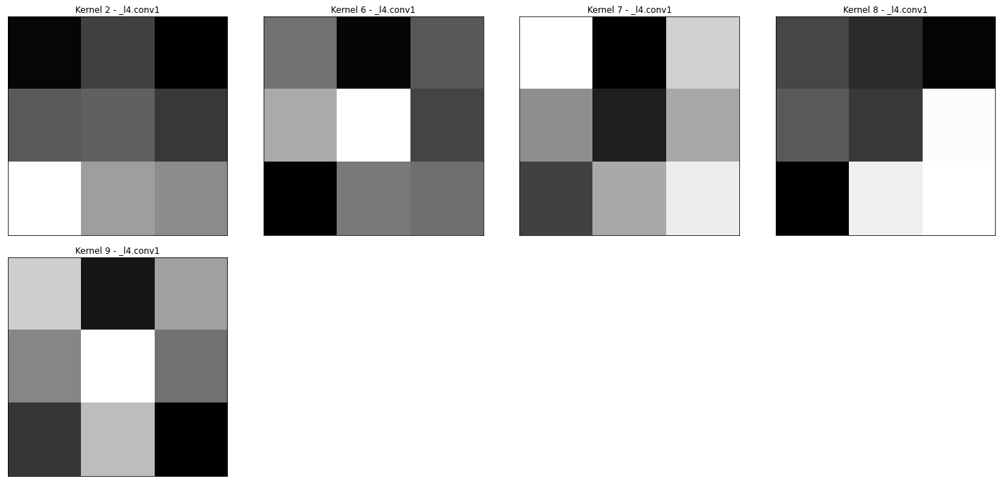

In [ ]:
kernels_idx = [2, 6 , 7, 8, 9]
erm.show_kernels(layers, kernels_list, kernels_idx)

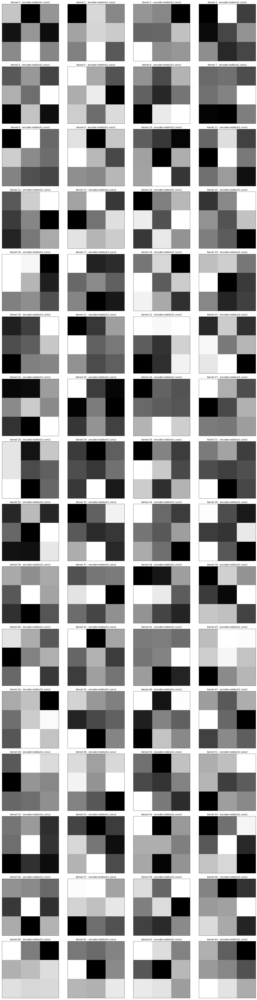

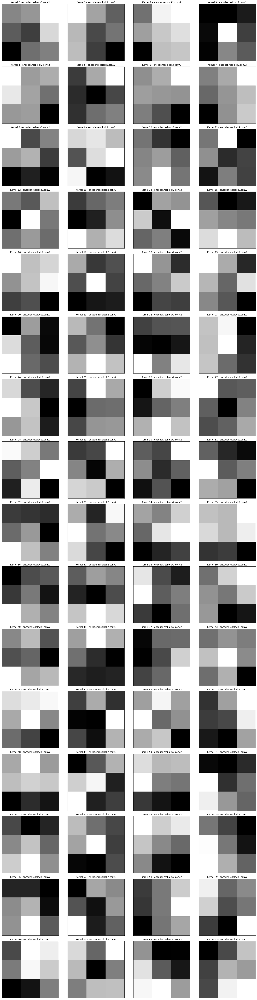

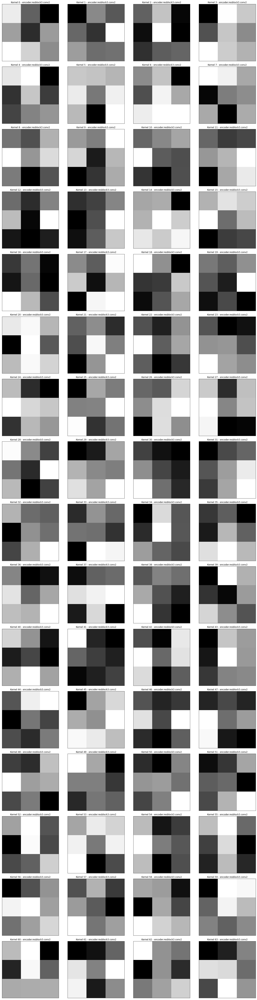

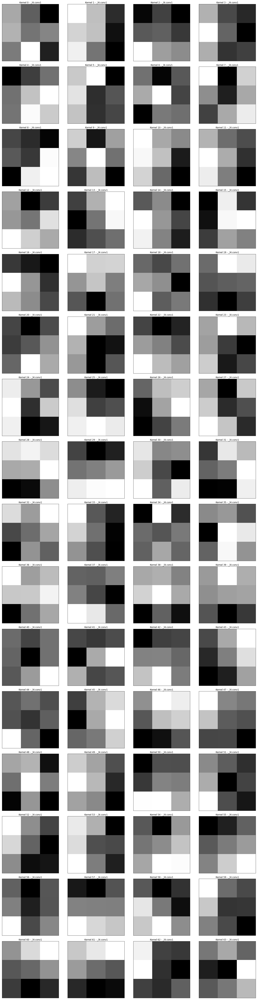

In [ ]:
erm.show_kernels(layers, kernels_list)

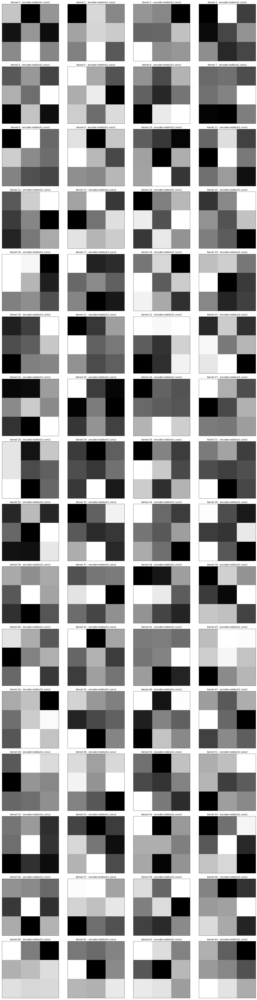

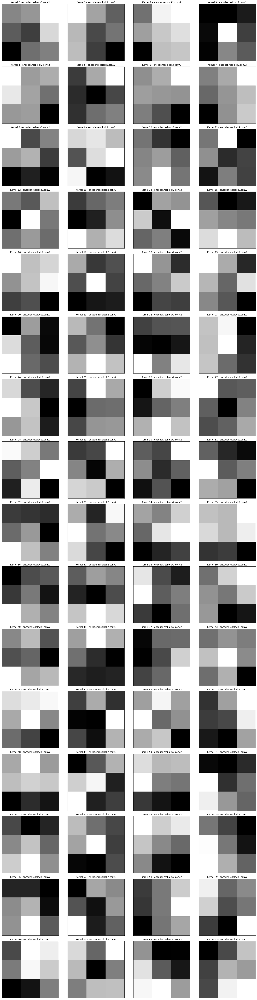

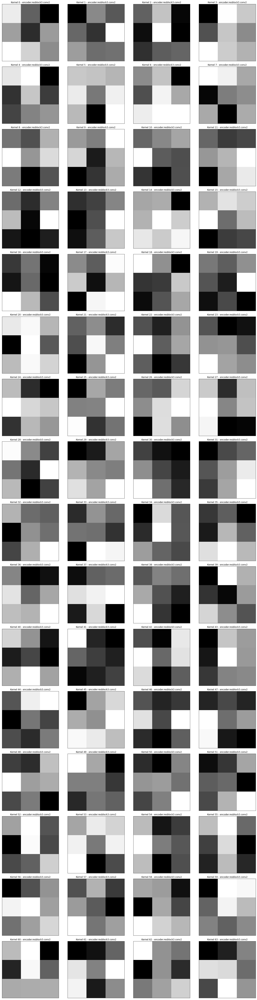

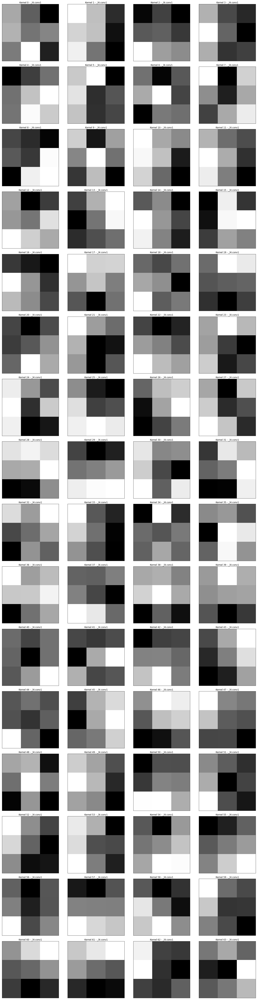

In [ ]:
show_kernels_v2(kernels_list)

In [ ]:
kernels = erm.get_ker


nels(layers['layer'][0])

In [ ]:
layers['layer'][0]

Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)

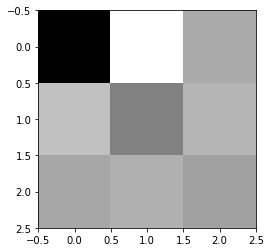

In [ ]:
plt.imshow(kernels[0][0], 'gray', interpolation = None)

In [ ]:
kernels.shape

torch.Size([64, 64, 3, 3])

In [ ]:
for i in range(3):  
  fig = plt.figure(figsize=[7, 9])

  idx = 1  

  # Plot Feature map
  fig = plt.subplot(2, 2, idx)
  # displaying the title
  plt.title("Feature map - "+ str(i), fontsize=20)
  ax = plt.imshow(layers_fm_list[0][i], 'gray')

  ax.axes.get_xaxis().set_visible(False)
  ax.axes.get_yaxis().set_visible(False)

  plt.subplots_adjust(wspace=0.03, hspace=0)
  plt.tight_layout()

  # Plot corresponding Kernel
  fig = plt.subplot(2, 2, idx+1)

  # displaying the title
  plt.title("Kernel - "+ str(i), fontsize=20)
  ax = plt.imshow(kernels_cpu[i][0], 'gray', interpolation = None)

  ax.axes.get_xaxis().set_visible(False)
  ax.axes.get_yaxis().set_visible(False)

  plt.subplots_adjust(wspace=0.03, hspace=0)
  plt.tight_layout()

